In [1]:
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from warnings import filterwarnings

filterwarnings('ignore')

## Problem: California Housing Dataset

### Data Description:
The dataset contains 20,640 samples and 9 features.
The features are:
- MedInc: median income in block
- HouseAge: median house age in block
- AveRooms: average number of rooms
- AveBedrms: average number of bedrooms
- Latitude: house block latitude
- Longitude: house block longitude
- AveOccup: average number of occupants per household

And the target is:
- MedHouseVal: median house value in block

## Data Visualization

In [2]:
from sklearn.datasets import fetch_california_housing

df = fetch_california_housing()
target = pd.Series(df.target, name='MedHouseVal')
df = pd.DataFrame(df.data, columns=df.feature_names)
df = pd.concat([df, target], axis=1)
df.columns = [c.lower() for c in df.columns]

In [3]:
df.describe()

,medinc,houseage,averooms,avebedrms,population,aveoccup,latitude,longitude,medhouseval
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,3.870671,28.639486,5.429000,1.096675,1425.476744,3.070655,35.631861,-119.569704,2.068558
std,1.899822,12.585558,2.474173,0.473911,1132.462122,10.386050,2.135952,2.003532,1.153956
min,0.499900,1.000000,0.846154,0.333333,3.000000,0.692308,32.540000,-124.350000,0.149990
25%,2.563400,18.000000,4.440716,1.006079,787.000000,2.429741,33.930000,-121.800000,1.196000
50%,3.534800,29.000000,5.229129,1.048780,1166.000000,2.818116,34.260000,-118.490000,1.797000
75%,4.743250,37.000000,6.052381,1.099526,1725.000000,3.282261,37.710000,-118.010000,2.647250
max,15.000100,52.000000,141.909091,34.066667,35682.000000,1243.333333,41.950000,-114.310000,5.000010


In [4]:
features = [f for f in df.columns if f not in ['medhouseval']]
target = 'medhouseval'

X = df[features]
y = df[target]

In [5]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

from sklearn.linear_model import LinearRegression

ols = LinearRegression()
ols.fit(X_train, y_train)

LinearRegression()

In [6]:
def create_regression_plot(X_train, X_test, y_train, y_test, model, alpha=0.25, s=10):

    y_train_hat = model.predict(X_train)
    y_test_hat = model.predict(X_test)

    train_mse = mean_squared_error(y_train, y_train_hat)
    test_mse = mean_squared_error(y_test, y_test_hat)

    train_r2 = r2_score(y_train, y_train_hat)
    test_r2 = r2_score(y_test, y_test_hat)

    train_residuals = y_train - y_train_hat
    test_residuals = y_test - y_test_hat

    fig, ax = plt.subplots(1, 4, figsize=(15, 4.5))

    sns.scatterplot(x=y_train_hat, y=y_train, ax=ax[0], alpha=alpha, s=s)
    ax[0].set_xlabel('Predicted Values\nTrain R2: {:.3f}'.format(train_r2))
    ax[0].set_ylabel('True Values')
    ax[0].set_title('Train: Predicted vs True Values')
    
    sns.scatterplot(x=y_train_hat, y=train_residuals, ax=ax[1], alpha=alpha, color='red', s=s)
    ax[1].set_xlabel('Predicted Values\nTrain MSE: {:.3f}'.format(train_mse))
    ax[1].set_ylabel('Residuals')
    ax[1].set_title('Train: Residuals vs Predicted Values')

    sns.scatterplot(x=y_test_hat, y=y_test, ax=ax[2], alpha=alpha, s=s)
    ax[2].set_xlabel('Predicted Values\nTest R2: {:.3f}'.format(test_r2))
    ax[2].set_ylabel('True Values')
    ax[2].set_title('Test: Predicted vs True Values')

    sns.scatterplot(x=y_test_hat, y=test_residuals, ax=ax[3], alpha=alpha, color='red', s=s)
    ax[3].set_xlabel('Predicted Values\nTest MSE: {:.3f}'.format(test_mse))
    ax[3].set_ylabel('Residuals')
    ax[3].set_title('Test: Residuals vs Predicted Values')

    fig.suptitle('Regression Plots')

    plt.tight_layout()
    plt.show()

## Control Model 
- Before doing any feature engineering, lets try to fit a simple linear model to the data and see how well it performs 

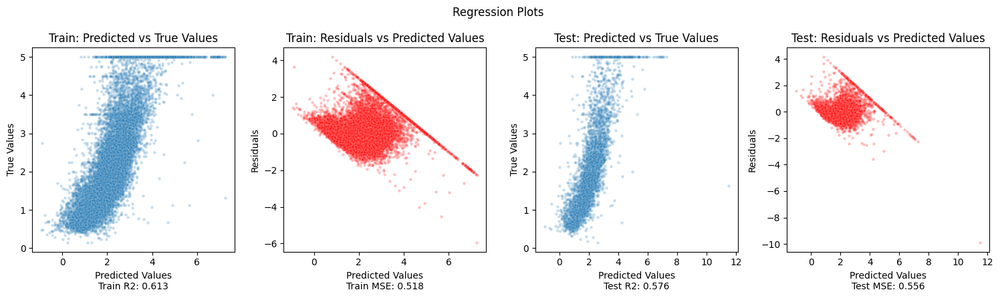

In [7]:
create_regression_plot(X_train, X_test, y_train, y_test, ols)

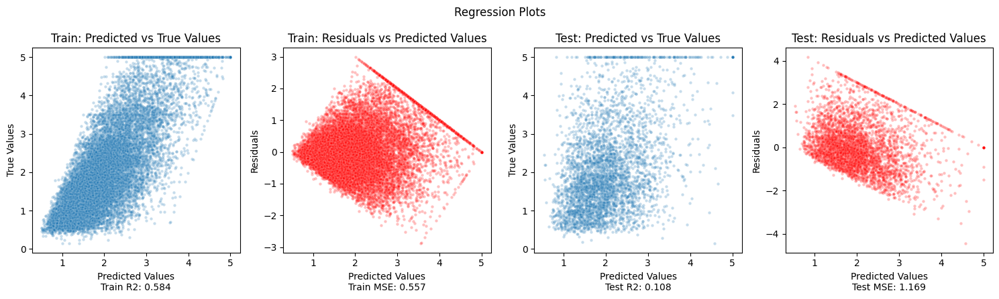

In [8]:
from sklearn.neighbors import KNeighborsRegressor

knn = KNeighborsRegressor(n_neighbors=3)
knn.fit(X_train, y_train)

create_regression_plot(X_train, X_test, y_train, y_test, knn)

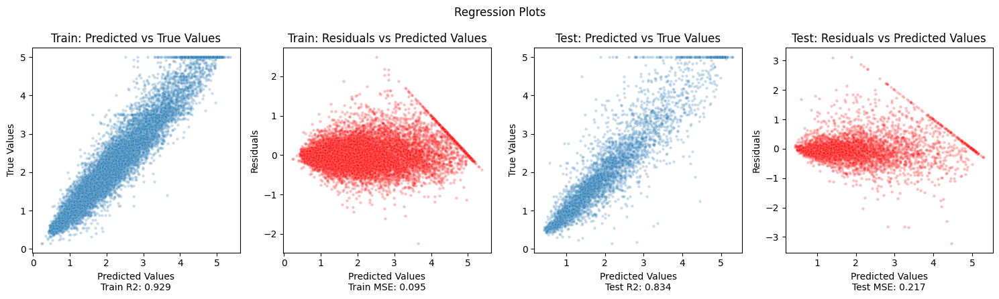

In [9]:
from sklearn.ensemble import GradientBoostingRegressor

gb = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=7, random_state=42)
gb.fit(X_train, y_train)

create_regression_plot(X_train, X_test, y_train, y_test, gb)

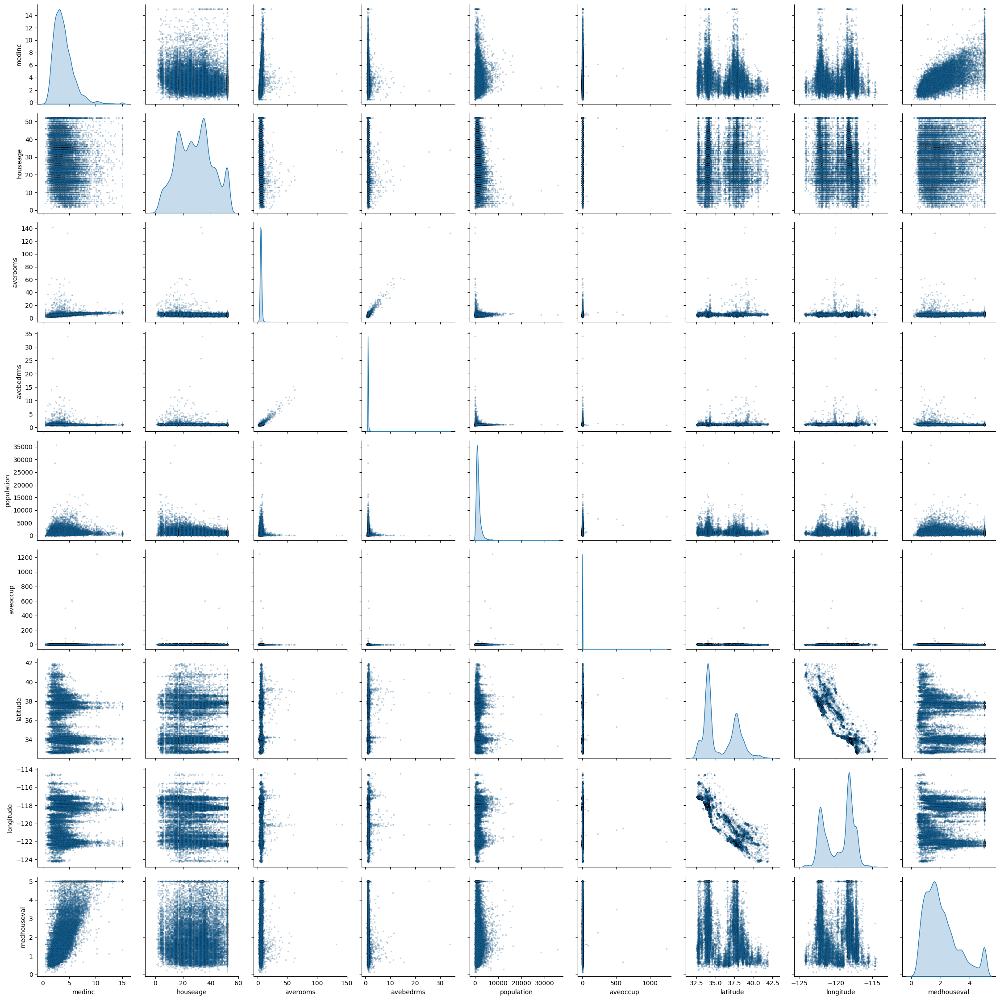

In [10]:
def create_pairwise_scatter_plot(df, features):
    sns.pairplot(df[features], diag_kind='kde', plot_kws={'alpha': 0.25, 's': 5, 'edgecolor': 'k'})
    plt.tight_layout()
    plt.show()

create_pairwise_scatter_plot(df, df.columns)

- Seems a little hard to get an idea of the distributions because of outliers.
- Let's remove them and see if we can get a better idea.

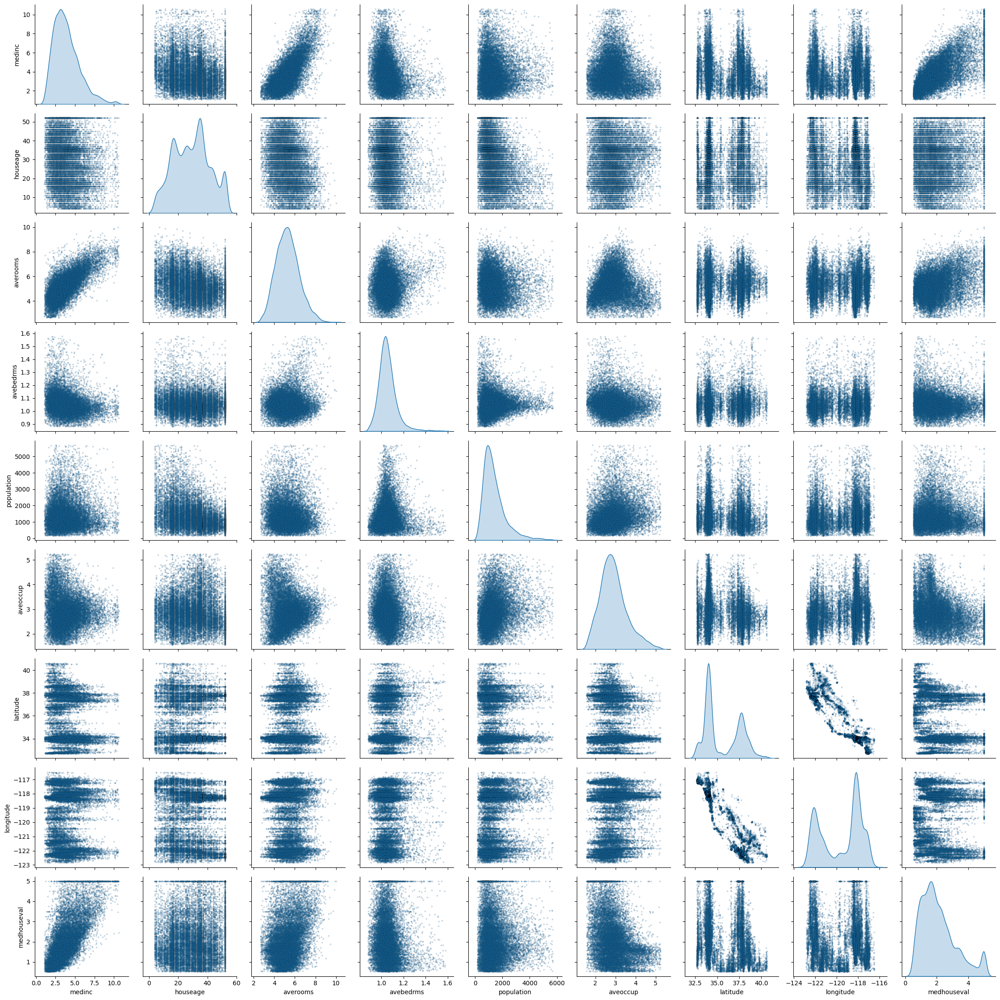

In [11]:
def remove_outliers(df, features, p_threshold=0.01):
    for feature in features:
        q1 = df[feature].quantile(p_threshold)
        q3 = df[feature].quantile(1 - p_threshold)
        df = df[df[feature].between(q1, q3)]
    return df

df_no_outliers = remove_outliers(df, df.columns)
create_pairwise_scatter_plot(df_no_outliers, df_no_outliers.columns)

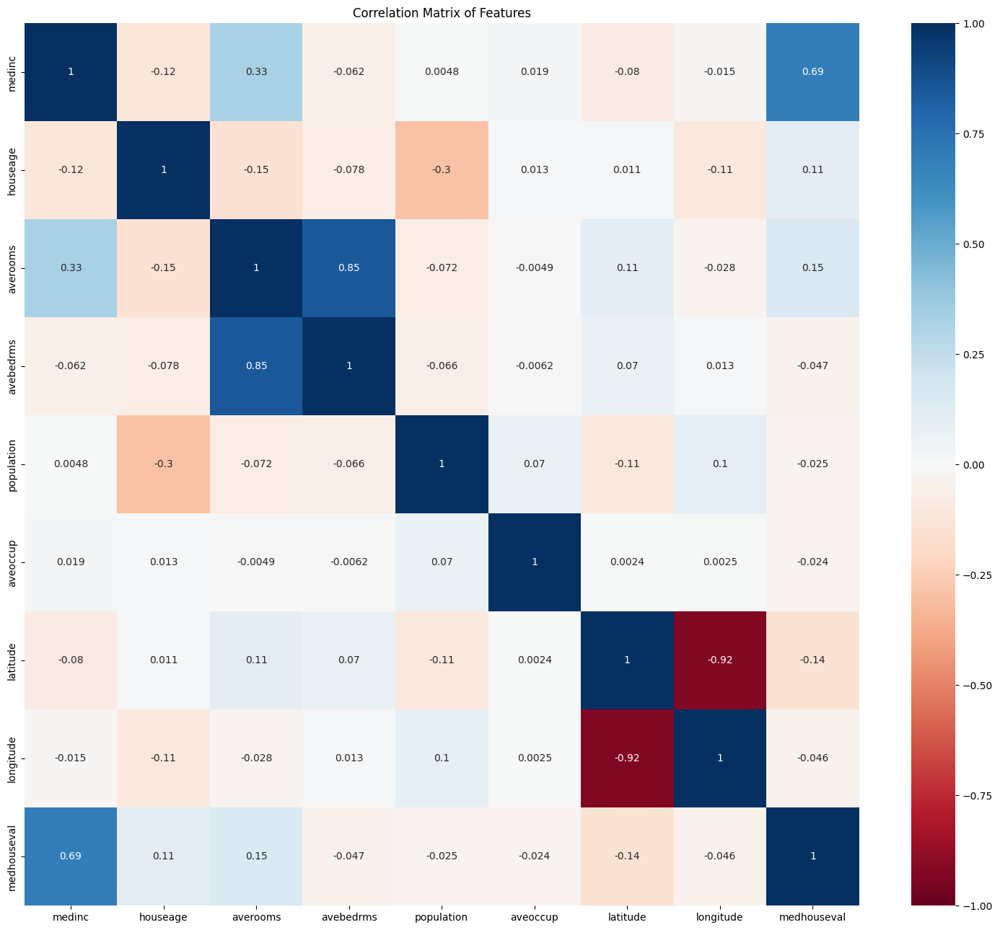

In [12]:
def create_correlation_matrix(df, features):
    corr_matrix = df[features].corr()
    plt.figure(figsize=(15, 13))
    sns.heatmap(corr_matrix, annot=True, vmin=-1, vmax=1, center=0, cmap='RdBu')
    plt.title('Correlation Matrix of Features')
    plt.tight_layout()
    plt.show()

create_correlation_matrix(df, df.columns)

## Data Preprocessing
All of the features seem approximately normal except for the latitude and longitude, which seem to be bimodal.
- Lets Try to create a new feature that captures "north_south" and "east_west" directionality.
- Then the new features should be more normally distributed, along with a indicator of the directionality

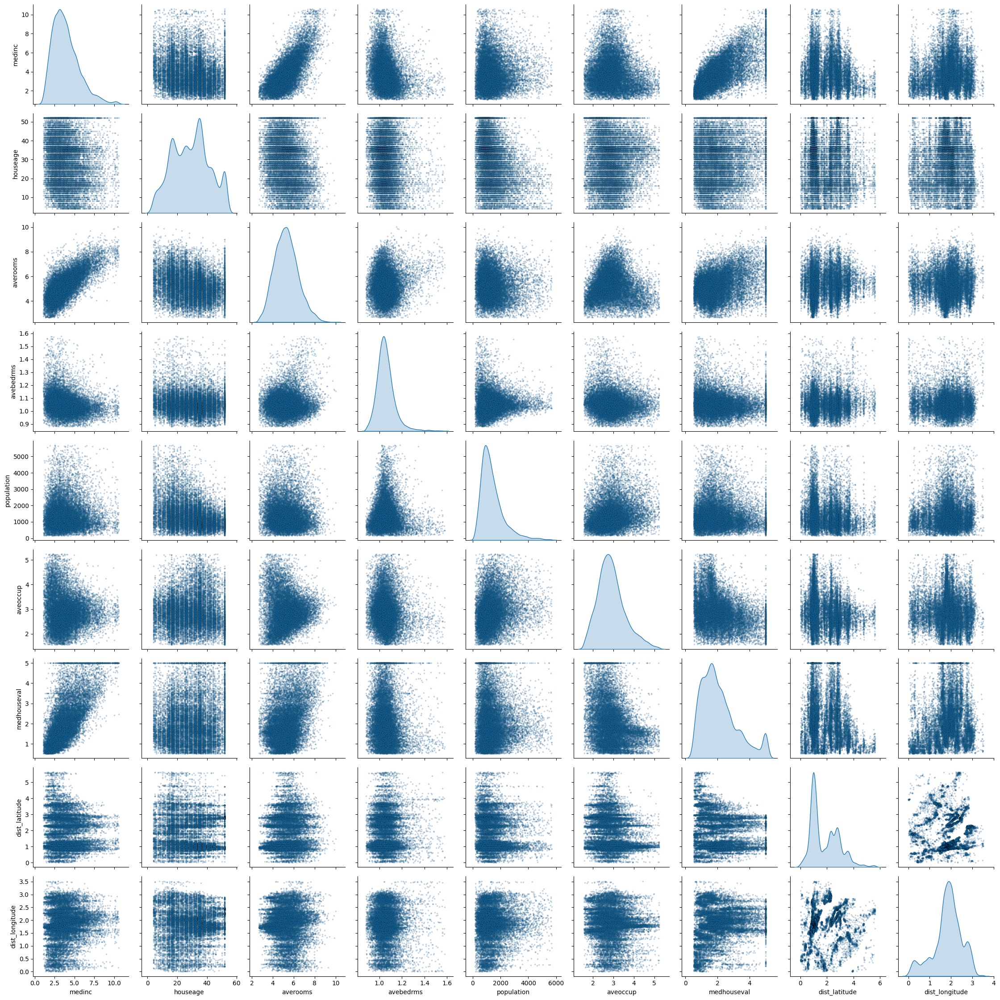

In [13]:
df_no_outliers['east_west'] = np.where(df_no_outliers['longitude'] < -120, 1, -1)
df_no_outliers['north_south'] = np.where(df_no_outliers['latitude'] > 35, 1, -1)

df_no_outliers['dist_latitude'] = abs(df_no_outliers['latitude'] - 35)
df_no_outliers['dist_longitude'] = abs(df_no_outliers['longitude'] + 120)

plot_columns = [c for c in df_no_outliers.columns if c not in ['latitude', 'longitude', 'east_west', 'north_south']]
create_pairwise_scatter_plot(df_no_outliers, plot_columns)

- Some of the features seem to be closer to log-normal distributions.
- Let's try to transform them in a log-space to make them more normally distributed.

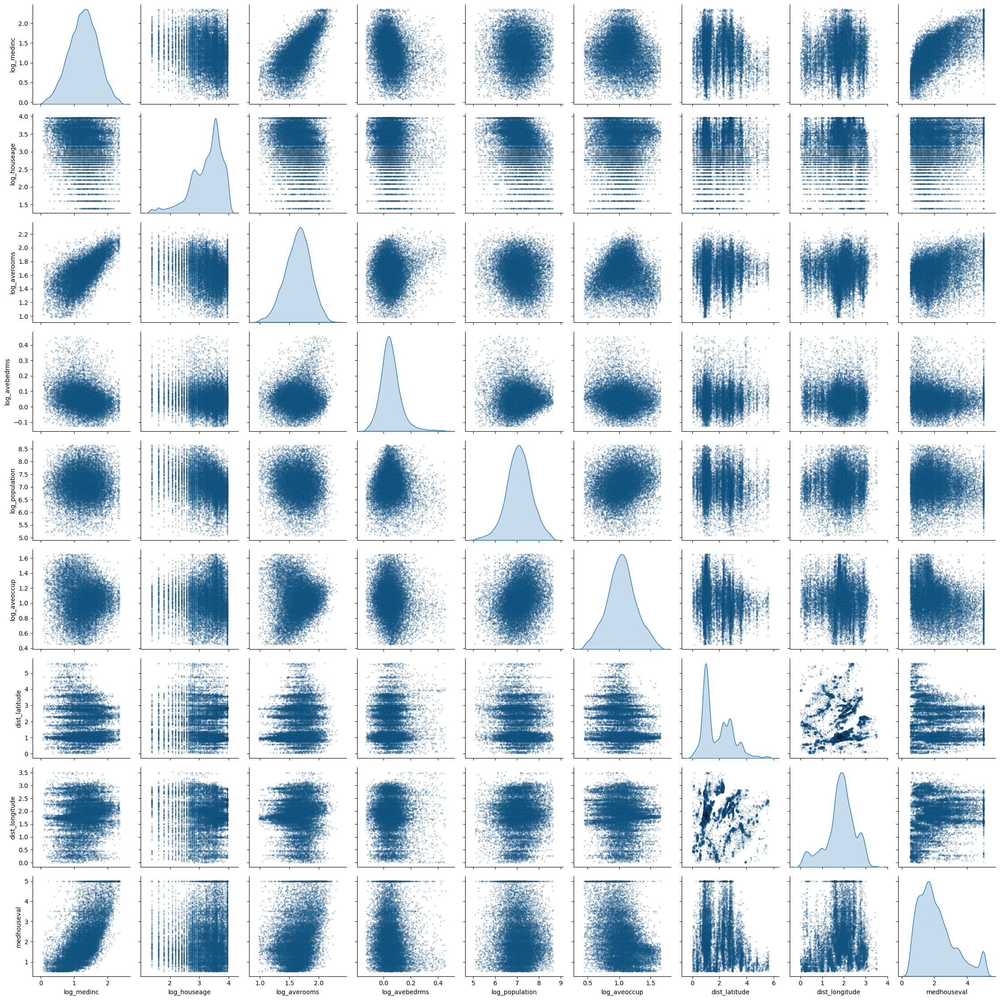

In [14]:
log_features = [f for f in plot_columns if f not in ['latitude', 'longitude', 'east_west', 'north_south', 'dist_latitude', 'dist_longitude', 'medhouseval']]

for feature in log_features:
    df_no_outliers[f'log_{feature}'] = np.log(df_no_outliers[feature])

create_pairwise_scatter_plot(df_no_outliers, ['log_' + f for f in log_features] + ['dist_latitude', 'dist_longitude', 'medhouseval'])

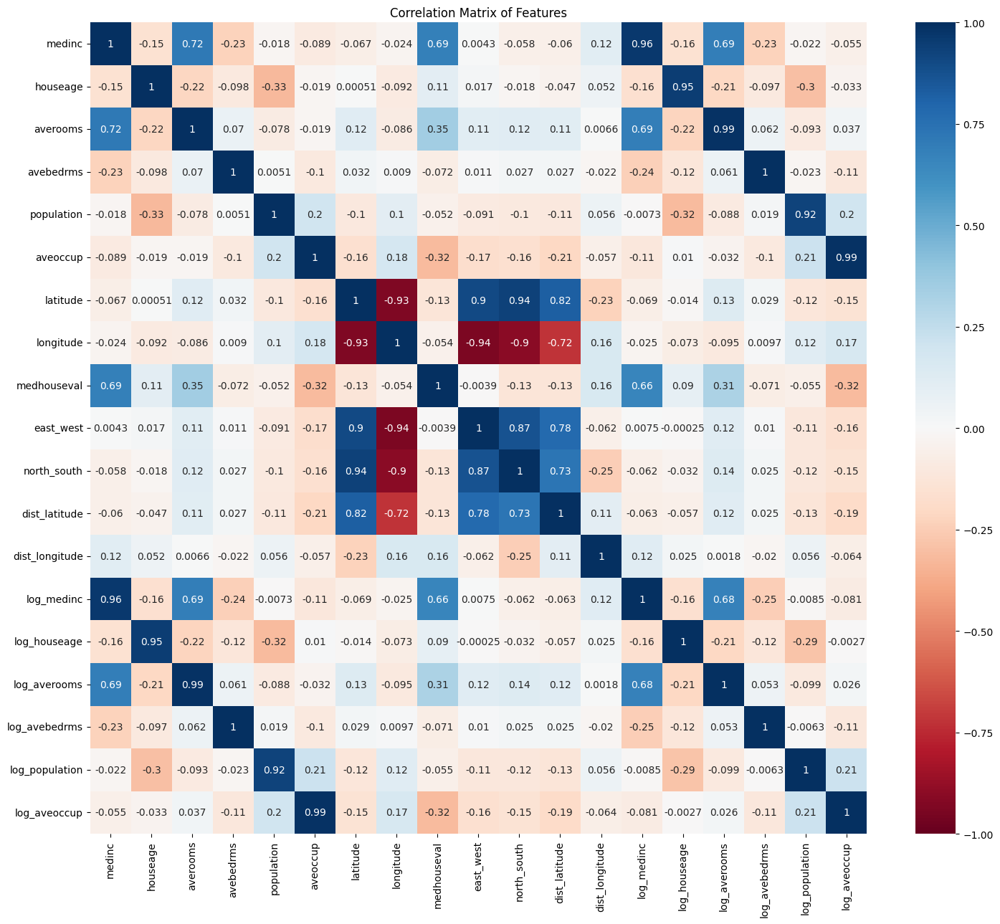

In [15]:
create_correlation_matrix(df_no_outliers, df_no_outliers.columns)

In [16]:
def apply_basic_transforms(_X):

    _X = _X.copy()
    
    _X['east_west'] = np.where(_X['longitude'] < -120, 1, -1)
    _X['north_south'] = np.where(_X['latitude'] > 35, 1, -1)

    _X['dist_latitude'] = abs(_X['latitude'] - 35)
    _X['dist_longitude'] = abs(_X['longitude'] + 120)

    for feature in log_features:
        _X[f'log_{feature}'] = np.log(_X[feature])

    return _X

In [17]:
from sklearn.preprocessing import PolynomialFeatures

def apply_poly_transform(_X, degree=2):
    _X = _X.copy()

    poly = PolynomialFeatures(degree=degree)
    _X = poly.fit_transform(_X)
    return _X

## Model Training
- Lets try to fit a simple linear model to the data and see how well it performs 
- Use k-fold cross validation to evaluate the model

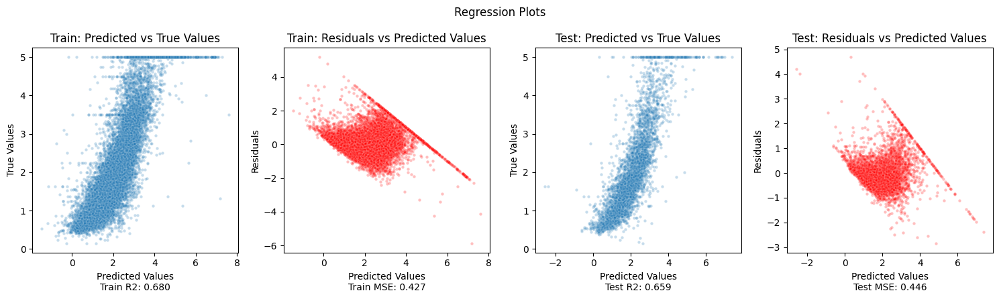

In [18]:
X_train_trans = apply_basic_transforms(X_train)
X_test_trans = apply_basic_transforms(X_test)

ols = LinearRegression()
ols.fit(X_train_trans, y_train)

y_train_hat = ols.predict(X_train_trans)
y_test_hat = ols.predict(X_test_trans)

create_regression_plot(X_train_trans, X_test_trans, y_train, y_test, ols)

- Lets try to fit a Lasso model to the data and see how well it performs 
- Will also need to standardize the data before fitting the model

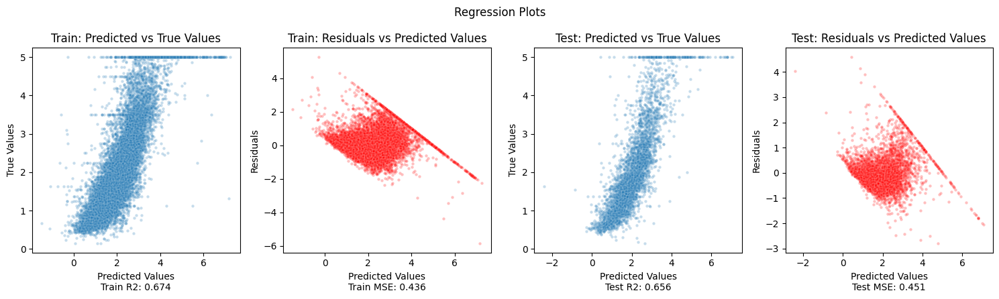

[ 0.79365523  0.12873007  0.          0.          0.01834949  0.04270536
 -0.58111398 -0.7611381   0.         -0.23892164 -0.02972953 -0.0136477
  0.00923733  0.         -0.11469083  0.12375806  0.01555765 -0.27407467]


In [19]:
from sklearn.linear_model import Lasso
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_trans_scaled = scaler.fit_transform(X_train_trans)
X_test_trans_scaled = scaler.transform(X_test_trans)

lasso = Lasso(alpha=0.01)
lasso.fit(X_train_trans_scaled, y_train)

create_regression_plot(X_train_trans_scaled, X_test_trans_scaled, y_train, y_test, lasso)
print(lasso.coef_)

- Lets also try to add interaction terms to the model and perform a lasso regression on the interaction terms

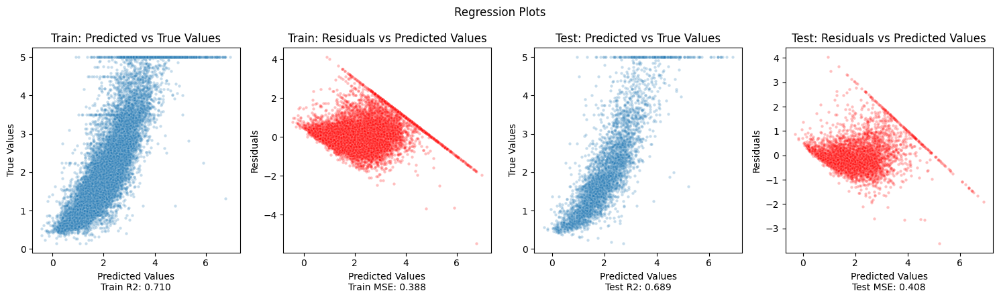

In [20]:
from sklearn.preprocessing import PolynomialFeatures

X_train_trans_poly = apply_poly_transform(X_train_trans)
X_test_trans_poly = apply_poly_transform(X_test_trans)

scaler = StandardScaler()
X_train_trans_poly = scaler.fit_transform(X_train_trans_poly)
X_test_trans_poly = scaler.transform(X_test_trans_poly)

lasso = Lasso(alpha=0.01)
lasso.fit(X_train_trans_poly, y_train)

create_regression_plot(X_train_trans_poly, X_test_trans_poly, y_train, y_test, lasso)

- It seems like the the extreme Y-values are being inaccurately predicted and affecting the model's performance.
- Lets also try a non-linear model to see if it performs better.

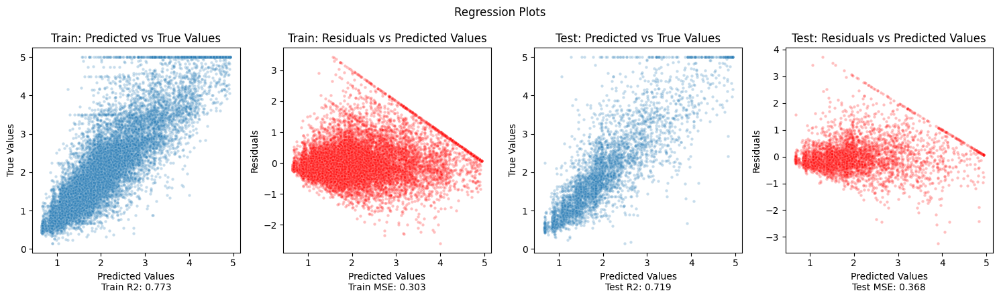

In [21]:
from sklearn.ensemble import RandomForestRegressor

rf = RandomForestRegressor(n_estimators=100, max_depth=7, random_state=42)
rf.fit(X_train_trans, y_train)

create_regression_plot(X_train_trans, X_test_trans, y_train, y_test, rf)

- Lets also try a Gradient Boosting model to see if it performs better.

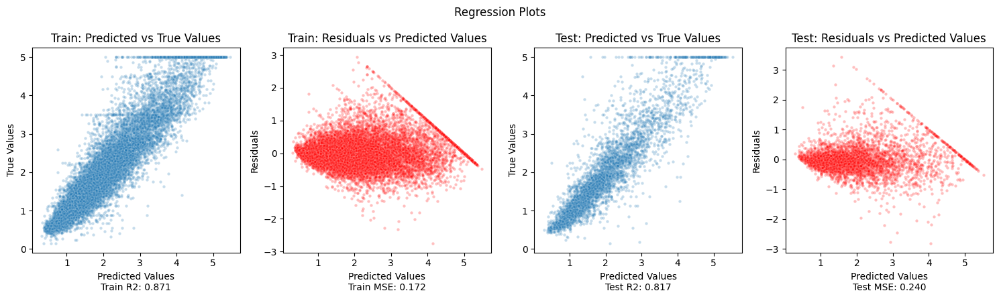

In [22]:
from sklearn.ensemble import GradientBoostingRegressor

gb = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=5, random_state=42)
gb.fit(X_train_trans, y_train)

create_regression_plot(X_train_trans, X_test_trans, y_train, y_test, gb)

- looks like the '5's are still messing with the model's performance.
- How about trying to predict the '5's separately using a classification model

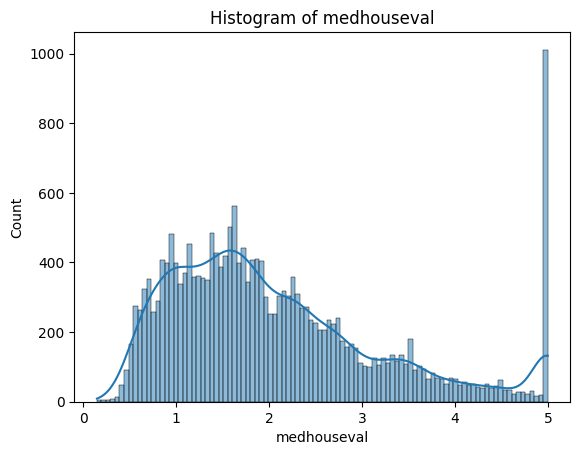

6.2693798449612395% of the data is 4.5 - 5


In [23]:
def plot_histogram(df, feature):
    sns.histplot(df[feature], bins=100, kde=True)
    plt.title(f'Histogram of {feature}')
    plt.show()

plot_histogram(df, 'medhouseval')

percentage_5s = len(df[df['medhouseval'] >= 4.5]) / len(df)
print(f'{percentage_5s * 100}% of the data is 4.5 - 5')

In [24]:
X_train_trans = apply_basic_transforms(X_train)
X_test_trans = apply_basic_transforms(X_test)

y_train_class = np.where(y_train >= 4.5, 1, 0)
y_test_class = np.where(y_test >= 4.5, 1, 0)

from sklearn.linear_model import LogisticRegression

log_reg = LogisticRegression()
log_reg.fit(X_train_trans, y_train_class)

LogisticRegression()

In [25]:
from sklearn.metrics import classification_report, accuracy_score

print("Training Classification Report:")
y_train_class_hat = log_reg.predict(X_train_trans)
print(classification_report(y_train_class, y_train_class_hat))

Training Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.99      0.98     15464
           1       0.82      0.46      0.59      1048

    accuracy                           0.96     16512
   macro avg       0.89      0.72      0.78     16512
weighted avg       0.95      0.96      0.95     16512



In [26]:
print("Testing Classification Report:")
y_test_class_hat = log_reg.predict(X_test_trans)
print(classification_report(y_test_class, y_test_class_hat))

Testing Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98      3882
           1       0.75      0.44      0.56       246

    accuracy                           0.96      4128
   macro avg       0.86      0.72      0.77      4128
weighted avg       0.95      0.96      0.95      4128



- Because of the class imbalance, can use a gradient boosting classifier to see if it performs better.

In [27]:
from sklearn.ensemble import GradientBoostingClassifier

gb_clf = GradientBoostingClassifier(n_estimators=50, learning_rate=0.1, max_depth=4, random_state=42)
gb_clf.fit(X_train_trans, y_train_class)

GradientBoostingClassifier(max_depth=4, n_estimators=50, random_state=42)

In [28]:
print("Training Classification Report:")
y_train_class_hat = gb_clf.predict(X_train_trans)
print(classification_report(y_train_class, y_train_class_hat))

Training Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.99      0.99     15464
           1       0.90      0.65      0.75      1048

    accuracy                           0.97     16512
   macro avg       0.94      0.82      0.87     16512
weighted avg       0.97      0.97      0.97     16512



In [29]:
print("Testing Classification Report:")
y_test_class_hat = gb_clf.predict(X_test_trans)
print(classification_report(y_test_class, y_test_class_hat))

Testing Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98      3882
           1       0.77      0.53      0.63       246

    accuracy                           0.96      4128
   macro avg       0.87      0.76      0.80      4128
weighted avg       0.96      0.96      0.96      4128



- Finally lets try the logisitc regression with the interaction terms and L1 penalty and see if its any better

In [30]:
X_train_trans_poly = apply_poly_transform(X_train_trans)
X_test_trans_poly = apply_poly_transform(X_test_trans)

scaler = StandardScaler()
X_train_trans_poly = scaler.fit_transform(X_train_trans_poly)
X_test_trans_poly = scaler.transform(X_test_trans_poly)

log_reg = LogisticRegression(penalty='l1', C=0.01, solver='liblinear')
log_reg.fit(X_train_trans_poly, y_train_class)

LogisticRegression(C=0.01, penalty='l1', solver='liblinear')

In [31]:
print('Training Classification Report:')
y_train_class_hat = log_reg.predict(X_train_trans_poly)
print(classification_report(y_train_class, y_train_class_hat))

Training Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98     15464
           1       0.85      0.41      0.55      1048

    accuracy                           0.96     16512
   macro avg       0.91      0.70      0.76     16512
weighted avg       0.95      0.96      0.95     16512



In [32]:
print('Testing Classification Report:')
y_test_class_hat = log_reg.predict(X_test_trans_poly)
print(classification_report(y_test_class, y_test_class_hat))

Testing Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.99      0.98      3882
           1       0.79      0.40      0.53       246

    accuracy                           0.96      4128
   macro avg       0.88      0.70      0.75      4128
weighted avg       0.95      0.96      0.95      4128



- Lets try a fully linear model with logistic classifier then regress on the non-5s separately


In [33]:
class LinearModel:

    def __init__(self, log_reg, lin_reg):
        self.log_reg = log_reg
        self.lin_reg = lin_reg

    def predict(self, _X):

        y_class_pred_hat = self.log_reg.predict(_X)

        _X_non_5s = _X[y_class_pred_hat == 0]

        y_non_5s_hat = self.lin_reg.predict(_X_non_5s)

        y_pred = np.zeros(_X.shape[0])
        y_pred[y_class_pred_hat == 1] = 5
        y_pred[y_class_pred_hat == 0] = y_non_5s_hat

        return y_pred

In [34]:
X_train_trans_poly = apply_poly_transform(X_train_trans)
X_test_trans_poly = apply_poly_transform(X_test_trans)

scaler = StandardScaler()
X_train_trans_poly = scaler.fit_transform(X_train_trans_poly)
X_test_trans_poly = scaler.transform(X_test_trans_poly)

log_reg = LogisticRegression(penalty='l1', C=0.01, solver='liblinear')
log_reg.fit(X_train_trans_poly, y_train_class)

lasso = Lasso(alpha=0.01)
lasso.fit(X_train_trans_poly, y_train)

Lasso(alpha=0.01)

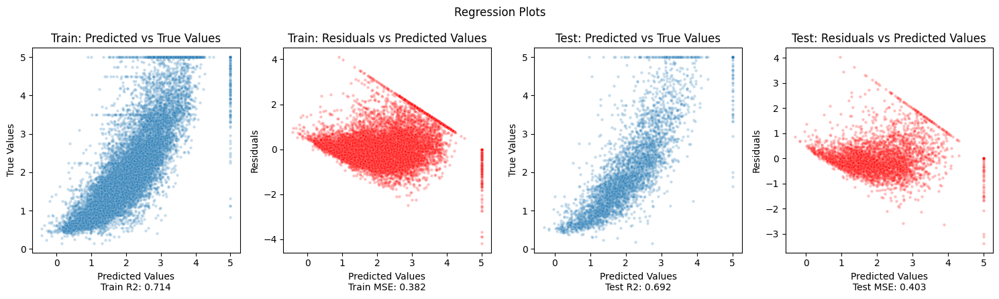

In [35]:
full_linear_model = LinearModel(log_reg, lasso)

create_regression_plot(X_train_trans_poly, X_test_trans_poly, y_train, y_test, full_linear_model)

In [36]:
class FullyGradientBoostedModel:

    def __init__(self, gb_clf, gb_reg):
        self.gb_clf = gb_clf
        self.gb_reg = gb_reg

    def predict(self, _X):
        
        y_class_pred_hat = self.gb_clf.predict(_X)

        _X_non_5s = _X[y_class_pred_hat == 0]

        y_non_5s_hat = self.gb_reg.predict(_X_non_5s)

        y_pred = np.zeros(_X.shape[0])
        y_pred[y_class_pred_hat == 1] = 5
        y_pred[y_class_pred_hat == 0] = y_non_5s_hat

        return y_pred

In [37]:
X_train_trans = apply_basic_transforms(X_train)
X_test_trans = apply_basic_transforms(X_test)

gb_clf = GradientBoostingClassifier(n_estimators=50, learning_rate=0.1, max_depth=7, random_state=42)
gb_reg = GradientBoostingRegressor(n_estimators=50, learning_rate=0.1, max_depth=7, random_state=42)

gb_clf.fit(X_train_trans, y_train_class)
gb_reg.fit(X_train_trans, y_train)

fully_gb_model = FullyGradientBoostedModel(gb_clf, gb_reg)

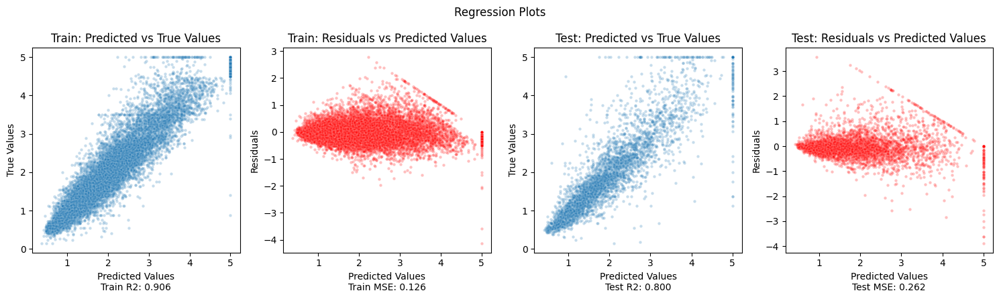

In [38]:
create_regression_plot(X_train_trans, X_test_trans, y_train, y_test, fully_gb_model)

- There might still be value to to be gained by considering location of houses and their relative values

In [39]:
def create_location_plot(df, feature):

    plt.figure(figsize=(5, 5))
    sns.scatterplot(x='longitude', y='latitude', hue=feature, data=df, palette='viridis', alpha=0.5, s=8)
    plt.show()

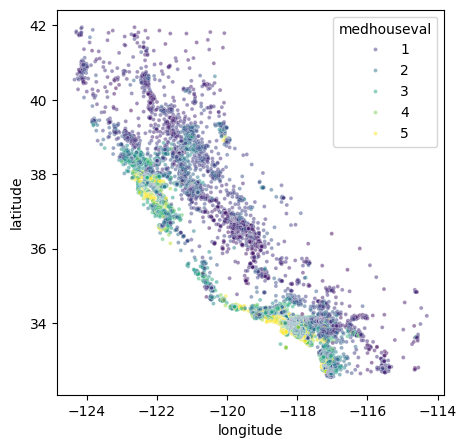

In [40]:
create_location_plot(df, 'medhouseval')

- let me try a clustering model to group similar localities together

In [41]:
from sklearn.cluster import KMeans

def add_cluster_column(df, n_clusters=10):

    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(df[['longitude', 'latitude']])
    df['location_cluster'] = kmeans.labels_
    return df

In [42]:
X_train_trans = apply_basic_transforms(X_train)
X_test_trans = apply_basic_transforms(X_test)

# X_train_trans = add_cluster_column(X_train_trans)
# X_test_trans = add_cluster_column(X_test_trans)

gb_cls = GradientBoostingClassifier(n_estimators=50, learning_rate=0.1, max_depth=6, random_state=42)
gb_cls.fit(X_train_trans, y_train_class)

gb_reg = GradientBoostingRegressor(n_estimators=50, learning_rate=0.1, max_depth=6, random_state=42)
gb_reg.fit(X_train_trans, y_train)

gb_cls_model = FullyGradientBoostedModel(gb_cls, gb_reg)

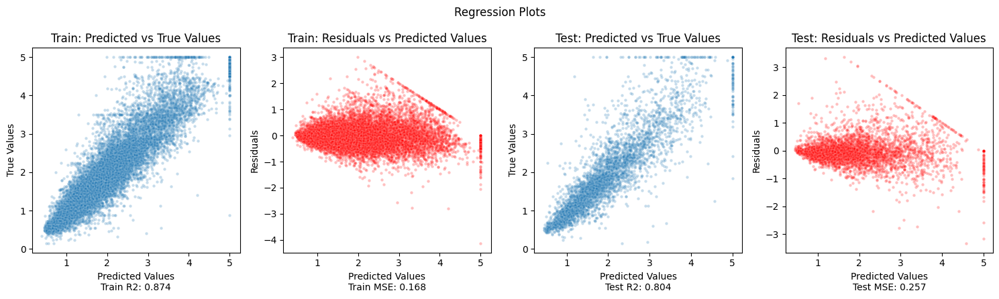

In [43]:
create_regression_plot(X_train_trans, X_test_trans, y_train, y_test, gb_cls_model)

In [44]:
log_reg = LogisticRegression(penalty='l1', C=0.01, solver='liblinear')
lasso = Lasso(alpha=0.01)

X_train_trans_poly = apply_poly_transform(X_train_trans, degree=2)
X_test_trans_poly = apply_poly_transform(X_test_trans, degree=2)

log_reg.fit(X_train_trans_poly, y_train_class)
lasso.fit(X_train_trans_poly, y_train)

fully_linear_model = LinearModel(log_reg, lasso)

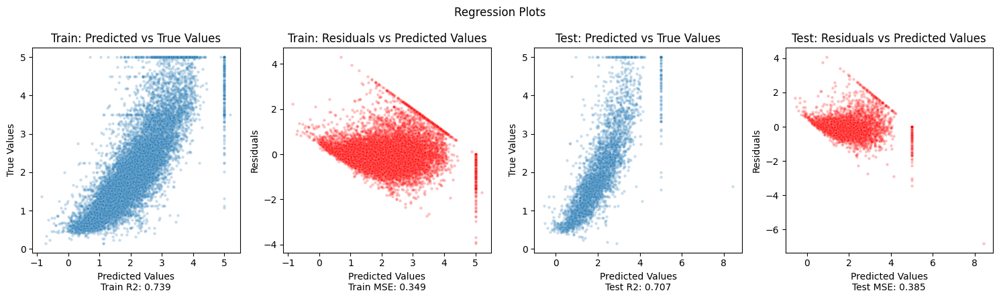

In [46]:
create_regression_plot(X_train_trans_poly, X_test_trans_poly, y_train, y_test, fully_linear_model)

- Lastly lets try to use splines to fit the data and see if it performs better

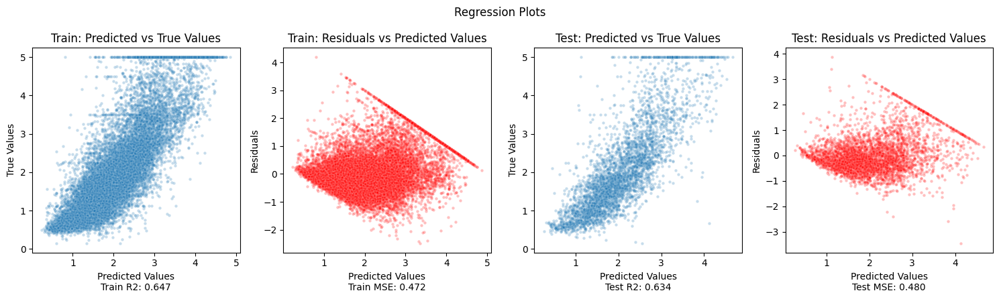

In [49]:
from sklearn.preprocessing import SplineTransformer

spline_transformer = SplineTransformer(degree=3, n_knots=15)

X_train_trans = apply_basic_transforms(X_train)
X_test_trans = apply_basic_transforms(X_test)

X_train_trans_spline = spline_transformer.fit_transform(X_train_trans)
X_test_trans_spline = spline_transformer.transform(X_test_trans)

lasso = Lasso(alpha=0.01)
lasso.fit(X_train_trans_spline, y_train)

create_regression_plot(X_train_trans_spline, X_test_trans_spline, y_train, y_test, lasso)